In [2]:
import os
import matplotlib.pyplot as plt
import skimage.io as io
from pycocotools.coco import COCO
import numpy as np

In [3]:
dataType = 'train2017'
dataDir = '/kaggle/input/coco-2017-dataset/coco2017'

img_dir = os.path.join(dataDir, dataType)
annFile = os.path.join(dataDir, 'annotations', f'instances_{dataType}.json')

print(f"Image directory: {img_dir}")
print(f"Annotation file: {annFile}")

Image directory: /kaggle/input/coco-2017-dataset/coco2017/train2017
Annotation file: /kaggle/input/coco-2017-dataset/coco2017/annotations/instances_train2017.json


In [4]:
print("Loading annotations...")
coco = COCO(annFile)
print("Annotations loaded.")

all_imgIds = coco.getImgIds()
print(f"Total images in {dataType}: {len(all_imgIds)}")

imgIds_subset = all_imgIds[:20000]
print(f"Working with a subset of: {len(imgIds_subset)} images.")

Loading annotations...
loading annotations into memory...
Done (t=23.73s)
creating index...
index created!
Annotations loaded.
Total images in train2017: 118287
Working with a subset of: 20000 images.



Starting visualization for 50 images with black background...


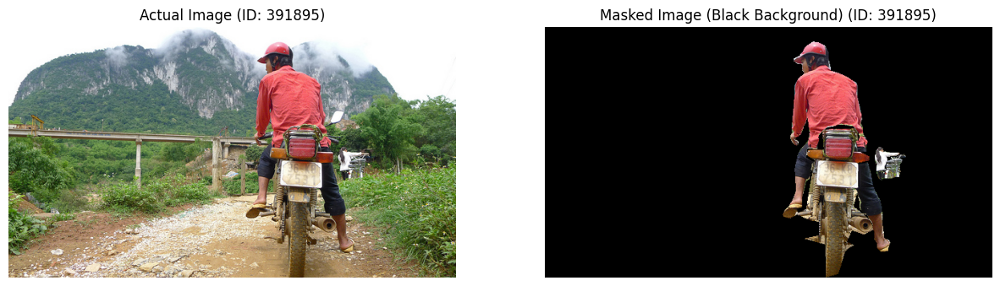

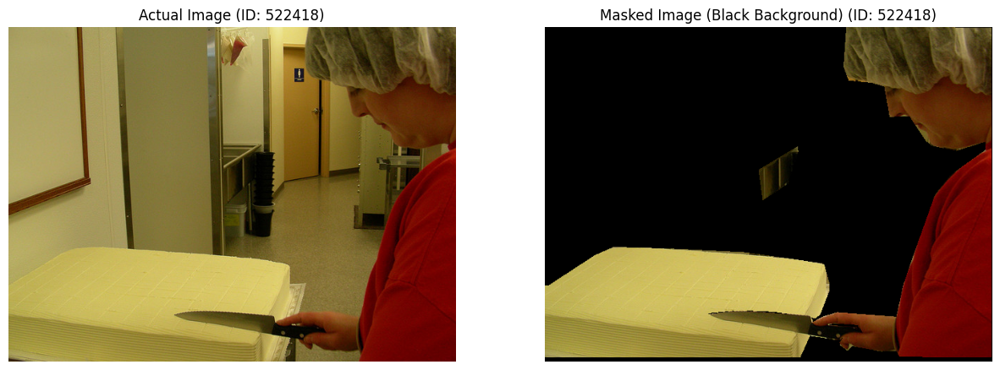

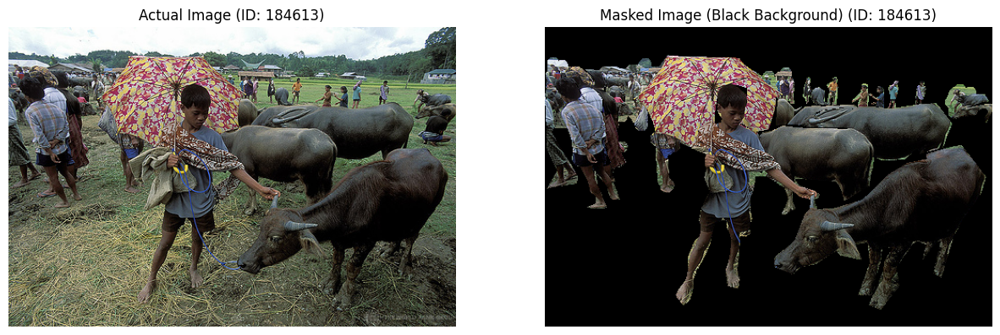

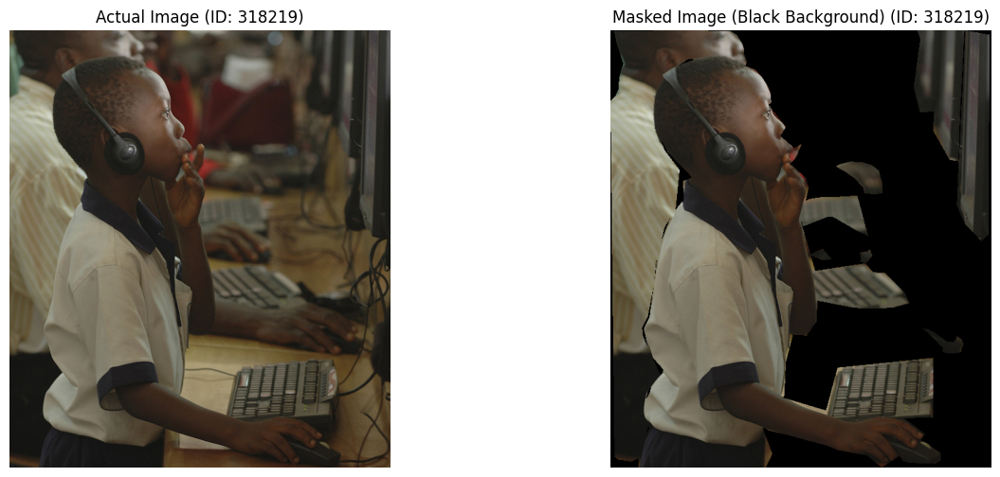

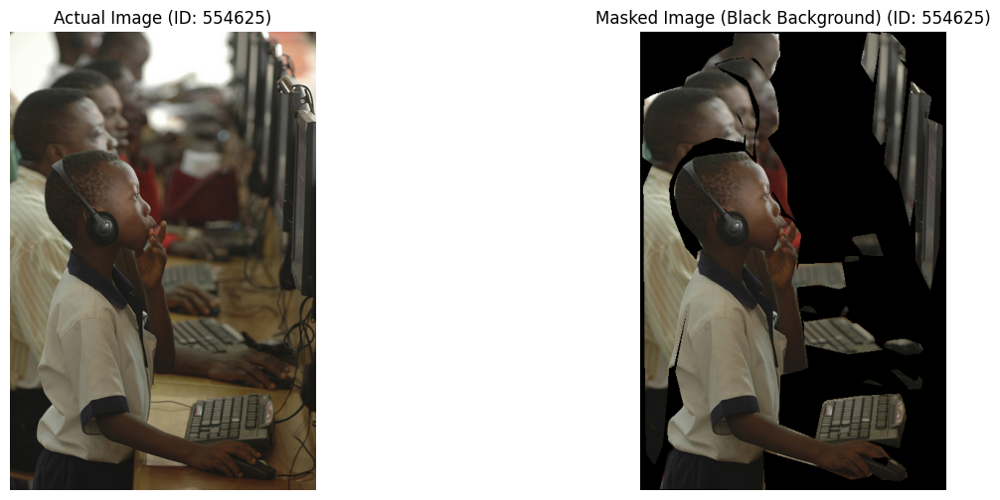

...

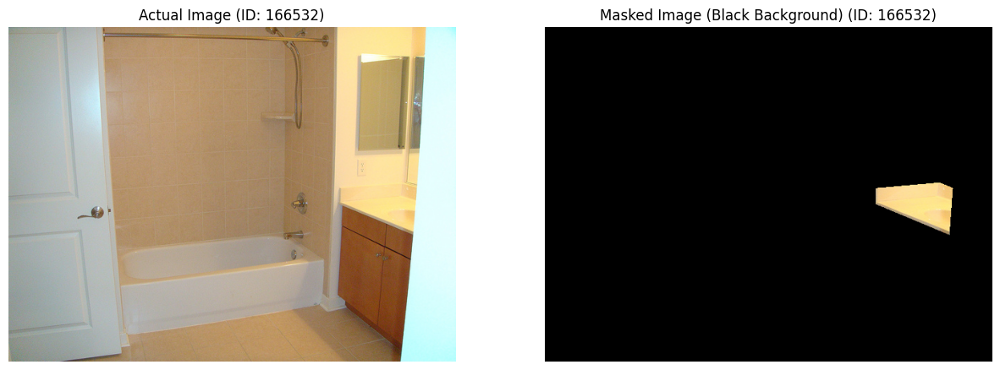

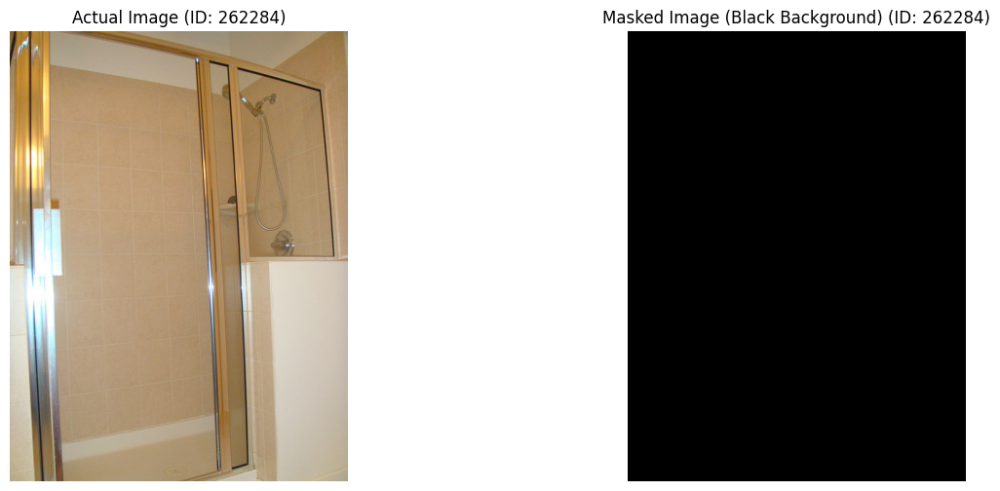

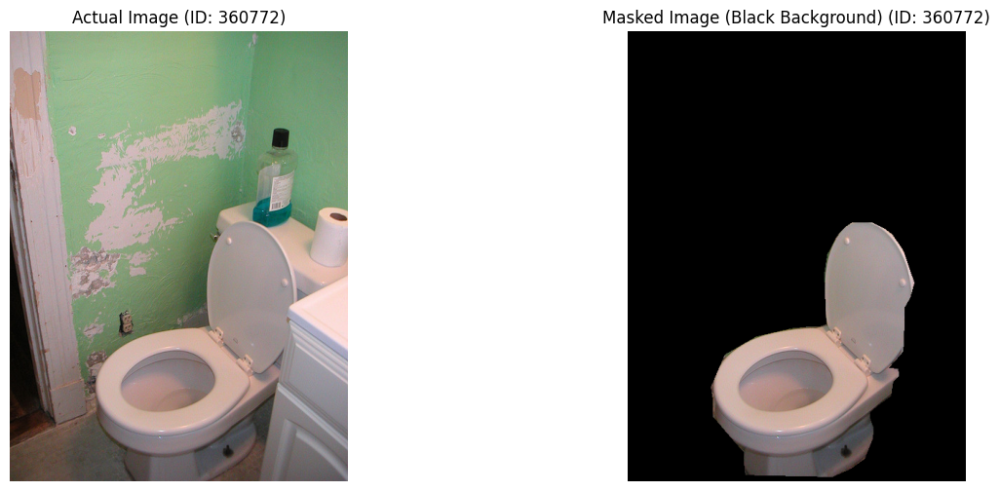

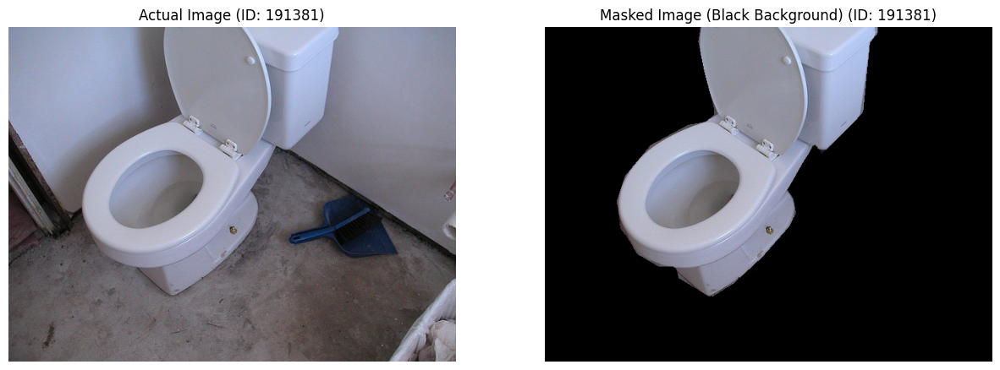

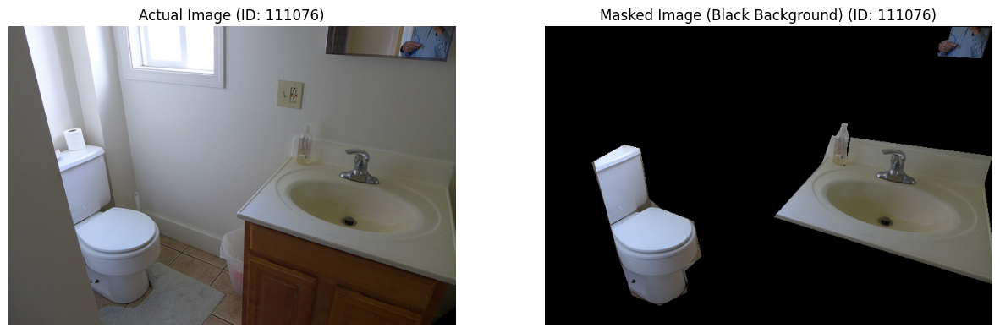

Visualization complete.


In [8]:
import os
import matplotlib.pyplot as plt
import skimage.io as io
from pycocotools.coco import COCO
import numpy as np 


imgIds_to_visualize = imgIds_subset[:50]
print(f"\nStarting visualization for 50 images with black background...")

for imgId in imgIds_to_visualize:
    
    img_info = coco.loadImgs(imgId)[0]
    img_path = os.path.join(img_dir, img_info['file_name'])
    
    I = io.imread(img_path)
    
    masked_image_black_bg = np.zeros_like(I, dtype=np.uint8)
    
    annIds = coco.getAnnIds(imgIds=img_info['id'])
    anns = coco.loadAnns(annIds)
    
    for ann in anns:
        mask = coco.annToMask(ann)
        
        masked_image_black_bg[mask > 0] = I[mask > 0]
            
    fig, ax = plt.subplots(1, 2, figsize=(15, 6))
    
    ax[0].imshow(I)
    ax[0].set_title(f'Actual Image (ID: {imgId})')
    ax[0].axis('off')
    
    ax[1].imshow(masked_image_black_bg)
    ax[1].set_title(f'Masked Image (Black Background) (ID: {imgId})')
    ax[1].axis('off')
    
    plt.show()

print("Visualization complete.")